In [52]:
# Import required packages
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [53]:
## Load datasets

path = r'/content/drive/MyDrive/datasets/ABS_Store_Inventory_and_alcohol_liquor_Sales.csv'
df = pd.read_csv(path, low_memory=False)


In [54]:
df.shape


(12625, 8)

In [55]:
df.sample(10)

,Code,Category,Description,Size,Total Inventory,Price,Sale Price,Sale End Date
9538,342473,GIN,Dogfish Head Compelling Gin,750ML,136,34.99,NaN,NaN
1986,312030,AMERICAN WHITE,Harken Barrel Fermented Chardonnay,750ML,435,12.99,NaN,NaN
10366,28053,SCOTCH,Inver House Green Plaid Very Rare Blended Scot...,1.75L,176,20.99,NaN,NaN
9623,41403,CANADIAN/BLENDED WHISKEY,McClintock Maryland Heritage White Whiskey,750ML,161,33.99,NaN,NaN
4076,34010,AMERICAN RED,Red Diamond Merlot,750ML,0,11.99,NaN,NaN
9576,71149,SPECIALTY,Stranahan's Colorado Whiskey,750ML,0,54.99,NaN,NaN
10383,41917,SPAIN/PORTUGAL,Vionta Albarino,750ML,0,16.49,NaN,NaN
11697,13660,DOMESTIC CAN,JUNESHINE ACAI 4/6 CANS - 6 Pack,12.0Z,0,17.99,NaN,NaN
2232,51322,AMERICAN RED,La Crema Pinot Noir,750ML,89,31.99,NaN,NaN
5951,70198,MIXERS,Master of Mixes Lite Margarita Mixer,1.75L,175,8.99,NaN,NaN


In [56]:
df.dtypes

Code                 int64
Category            object
Description         object
Size                object
Total Inventory      int64
Price              float64
Sale Price         float64
Sale End Date       object
dtype: object

In [57]:
df.isnull().sum()


Code                   0
Category              44
Description            0
Size                   0
Total Inventory        0
Price                  0
Sale Price         12447
Sale End Date      12447
dtype: int64

In [58]:
# Since there are 12447 null value in `Sale Price` and `Sale End Date` columns, so it's better to remove them

df.drop(['Sale Price', 'Sale End Date'], inplace=True, axis=1)


In [59]:
df['Category'].value_counts()


AMERICAN RED                    1377
ITALY                            831
AMERICAN WHITE                   794
FRANCE                           703
DOMESTIC CAN                     677
IMPORTED BOTTLE                  652
VODKA                            580
DOMESTIC BOTTLE                  511
BOURBON/RYE                      501
SPAIN/PORTUGAL                   493
CORDIALS                         434
CHAMPAGNE/SPARKLING              418
TEQUILA                          381
RUM                              342
OTHER WINE                       273
ARGENTINA                        263
MIXERS                           232
CHILE                            223
SCOTCH                           217
KOSHER                           210
AUSTRALIA                        192
CANADIAN/BLENDED WHISKEY         186
PORT/SHERRY/DESSERT/VERMOUTH     183
BRANDY/COGNAC/GRAPPA             176
AMERICAN TABLE                   172
GIN                              156
SPECIALTY                        150
A

In [60]:
df['Category'].unique()

array(['BOURBON/RYE', 'DOMESTIC CAN', 'FRANCE', 'VODKA',
       'DOMESTIC BOTTLE', 'AUSTRALIA', 'AMERICAN WHITE', 'GERMANY',
       'LIQ BASED RTD', 'AMERICAN RED', 'ITALY', 'NEW ZEALAND',
       'SPAIN/PORTUGAL', 'AMERICAN TABLE', 'AMERICAN BLUSH/ROSE',
       'MIXERS', 'GIN', 'OTHER WINE', 'MISCELLANEOUS IMPORTED',
       'MALT BASED SELTZER', 'IMPORTED CAN', 'BRANDY/COGNAC/GRAPPA',
       'RUM', 'WINE BASED SELTZER', 'CORDIALS', 'SCOTCH',
       'IMPORTED BOTTLE', 'CHAMPAGNE/SPARKLING', 'MEAD',
       'PORT/SHERRY/DESSERT/VERMOUTH', 'SPECIALTY', 'KOSHER', 'ARGENTINA',
       'COOLERS', 'CHILE', 'CANADIAN/BLENDED WHISKEY', 'TEQUILA',
       'GREECE', 'IRISH WHISKEY', 'SOUTH AFRICA', 'CIDER',
       'WINE BASED RTD', 'ALSACE', 'BEER', 'WINE CANS', 'ASIA', nan,
       'LIQ BASED SELTZER', 'MALT BASED RTD'], dtype=object)

In [61]:
# Fill the missing values in the `Category` column

most_frequent_category = df['Category'].mode()[0]
df['Category'].fillna(most_frequent_category, inplace=True)


In [62]:
# Change the object data type columns to category data type

df = df.astype({'Category':'category', 'Description':'category', 'Size':'category'})


In [63]:
df.dtypes

Code                  int64
Category           category
Description        category
Size               category
Total Inventory       int64
Price               float64
dtype: object

In [64]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12625 entries, 0 to 12624
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   Code             12625 non-null  int64   
 1   Category         12625 non-null  category
 2   Description      12625 non-null  category
 3   Size             12625 non-null  category
 4   Total Inventory  12625 non-null  int64   
 5   Price            12625 non-null  float64 
dtypes: category(3), float64(1), int64(2)
memory usage: 697.8 KB


In [65]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Code,12625.0,157636.052119,134093.187366,122.00,43523.00,83646.00,310743.00,739611.00
Total Inventory,12625.0,111.858059,367.454397,-318.00,0.00,0.00,81.00,8099.00
Price,12625.0,27.110106,65.063633,0.09,11.99,16.99,26.99,4828.99


In [66]:
# Check the duplicated rows

df.duplicated().sum()


0

In [67]:
# Check if there are outliers in the dataset and remove them

fig1 = px.box(df, y='Total Inventory', title='<b>Box Plot: Total Inventory</b>')
fig2 = px.box(df, y='Price', title='<b>Box Plot: Prices</b>')

fig1.show()
fig2.show()


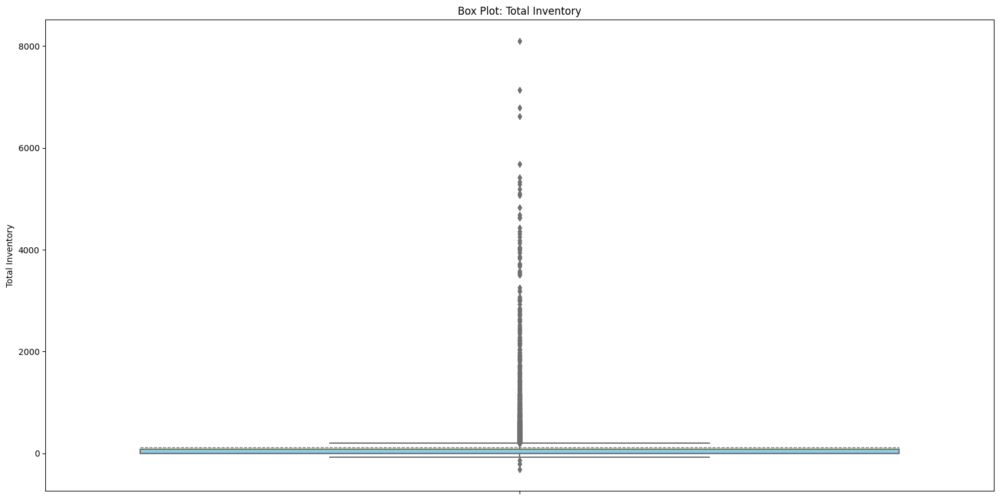

In [ ]:
# Check if there are outliers in the dataset and remove them

# Seaborn Package

plt.figure(figsize=(20, 10))

sns.boxplot(data=df, y='Total Inventory', color='skyblue', showmeans=True, meanline=True)
plt.title('Box Plot: Total Inventory')
plt.xlabel('')
plt.ylabel('Total Inventory')
plt.show()


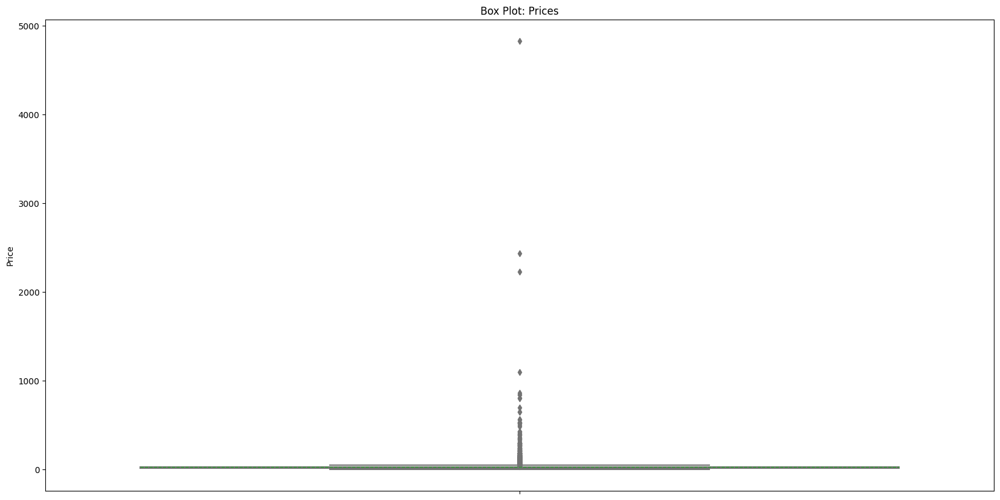

In [ ]:
plt.figure(figsize=(20, 10))
sns.boxplot(data=df, y='Price', color='lightgreen', showmeans=True, meanline=True)
plt.title('Box Plot: Prices')
plt.xlabel('')
plt.ylabel('Price')
plt.show()


In [ ]:
# Define the columns for outlier removal

columns_to_remove_outliers = ['Total Inventory', 'Price']

cleaned_df = df.copy()

for column in columns_to_remove_outliers:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    cleaned_df = cleaned_df[(cleaned_df[column] >= lower_bound) & (cleaned_df[column] <= upper_bound)]



In [ ]:
cleaned_df.shape

(9514, 6)

In [ ]:
cleaned_df.dtypes

Code                  int64
Category           category
Description        category
Size               category
Total Inventory       int64
Price               float64
dtype: object

In [ ]:
cleaned_df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 9514 entries, 1 to 12624
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   Code             9514 non-null   int64   
 1   Category         9514 non-null   category
 2   Description      9514 non-null   category
 3   Size             9514 non-null   category
 4   Total Inventory  9514 non-null   int64   
 5   Price            9514 non-null   float64 
dtypes: category(3), float64(1), int64(2)
memory usage: 686.9 KB


In [ ]:
cleaned_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Code,9514.0,167506.014190,137691.617906,122.00,44388.50,88267.00,317689.50,739611.00
Total Inventory,9514.0,19.087030,44.577522,-72.00,0.00,0.00,7.00,202.00
Price,9514.0,18.415388,9.915772,0.09,11.99,15.99,22.99,48.99


In [ ]:
# Export Cleaned Dataset
cleaned_df.to_csv('Cleaned_ABS_Store_Inventory_and_alcohol_liquor_Sales.csv', index=False)


In [ ]:
# Insight-1: Which category of alcohol has the highest total inventory?

# This plot using Plotly package

inventory_by_category = cleaned_df.groupby('Category')['Total Inventory'].sum().sort_values(ascending=False).reset_index()

highest_inventory_category = inventory_by_category.loc[inventory_by_category['Total Inventory'].idxmax(), 'Category']

print("Category with the highest total inventory:", highest_inventory_category)

fig = px.bar(inventory_by_category, x='Category', y='Total Inventory',
             title='<b>Which category of alcohol has the highest total inventory?<br>(Total Inventory by Category)</b>',
             labels={'Total Inventory': '<b>Inventory</b>'})

fig.update_layout(xaxis_title='<b>Category</b>', yaxis_title='<b>Total Inventory</b>')

fig.show()


Category with the highest total inventory: AMERICAN RED


Category with the highest total inventory: AMERICAN RED


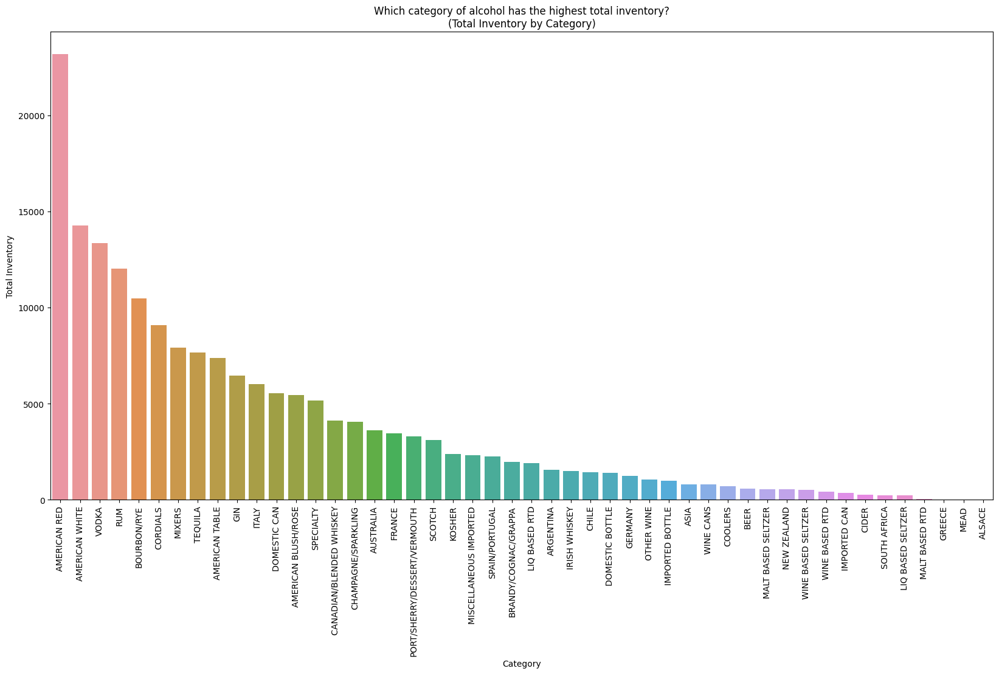

In [ ]:
# Insight-1: Which category of alcohol has the highest total inventory?

# This plot using Seaborn package

inventory_by_category = cleaned_df.groupby('Category')['Total Inventory'].sum().sort_values(ascending=False).reset_index()

highest_inventory_category = inventory_by_category.loc[inventory_by_category['Total Inventory'].idxmax(), 'Category']

print("Category with the highest total inventory:", highest_inventory_category)

plt.figure(figsize=(20, 10))

sns.barplot(data=inventory_by_category, x='Category', y='Total Inventory', order=inventory_by_category.sort_values('Total Inventory', ascending=False)['Category'])
plt.title('Which category of alcohol has the highest total inventory?\n(Total Inventory by Category)')
plt.xlabel('Category')
plt.ylabel('Total Inventory')
plt.xticks(rotation=90)

plt.show()


In [ ]:
# Insight-2: What is the average price of alcohol products in each category?

# This plot using Plotly package

average_price_by_category = cleaned_df.groupby('Category')['Price'].mean().sort_values(ascending=False).reset_index()

colors = px.colors.qualitative.Plotly

fig = px.bar(average_price_by_category, x='Category', y='Price', title='<b>What is the average price of alcohol products in each category?<br>(Average Price by Category)</b>',
             labels={'Price': 'Average Price'}, color='Category',
             color_discrete_sequence=colors)

fig.update_layout(xaxis_title='<b>Category</b>', yaxis_title='<b>Average Price</b>')

fig.show()


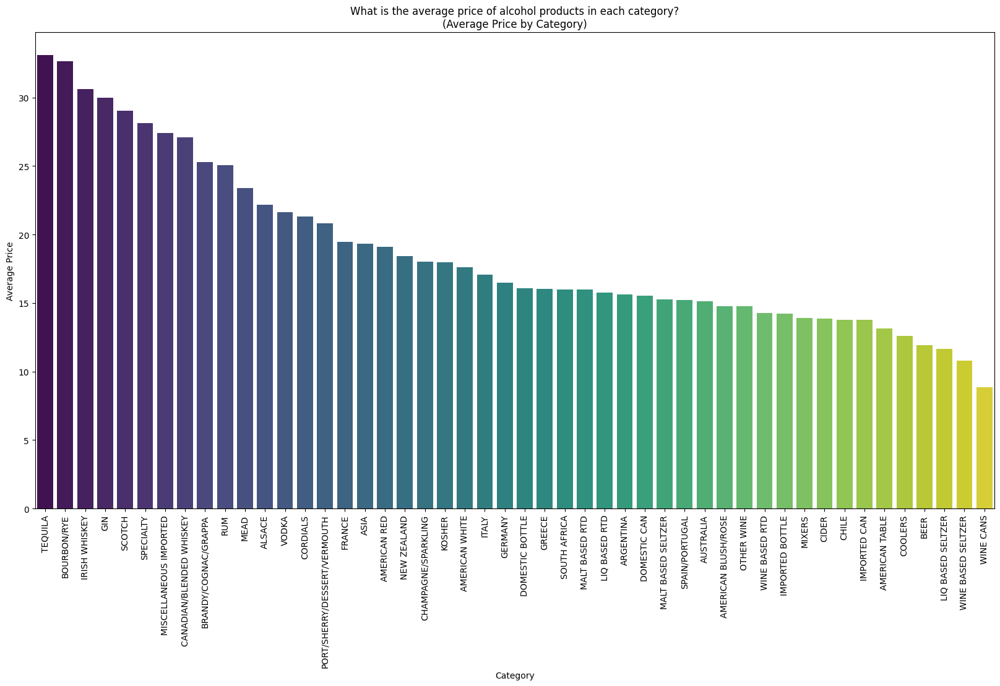

In [ ]:
# Insight-2: What is the average price of alcohol products in each category?

# This plot using Seaborn package

average_price_by_category = cleaned_df.groupby('Category')['Price'].mean().reset_index()

plt.figure(figsize=(20, 10))

sns.barplot(data=average_price_by_category, x='Category', y='Price', palette='viridis', order=average_price_by_category.sort_values('Price', ascending=False)['Category'])
plt.title('What is the average price of alcohol products in each category?\n(Average Price by Category)')
plt.xlabel('Category')
plt.ylabel('Average Price')
plt.xticks(rotation=90)

plt.show()


In [ ]:
average_price_by_category.sort_values(by='Price', ascending=False)


,Category,Price
43,TEQUILA,33.102667
9,BOURBON/RYE,32.633927
25,IRISH WHISKEY,30.601765
21,GIN,29.976842
39,SCOTCH,29.030816
42,SPECIALTY,28.119890
33,MISCELLANEOUS IMPORTED,27.397547
11,CANADIAN/BLENDED WHISKEY,27.072000
10,BRANDY/COGNAC/GRAPPA,25.308072
38,RUM,25.064597


In [ ]:
# Insight-3: How does the inventory distribution vary across different sizes of alcohol products?

# This plot using Plotly package

inventory_distribution = cleaned_df.groupby('Size')['Total Inventory'].describe().reset_index()
colors = px.colors.qualitative.Plotly

fig = px.bar(inventory_distribution, x='Size', y='count', title='<b>Inventory Distribution by Size</b>',
             labels={'Size': '<b>Alcohol Size</b>', 'count': '<b>Inventory Count</b>'}, color='Size',
             color_discrete_sequence=colors)

fig.update_layout(xaxis_title='<b>Size</b>', yaxis_title='<b>Inventory Count</b>')

fig.show()



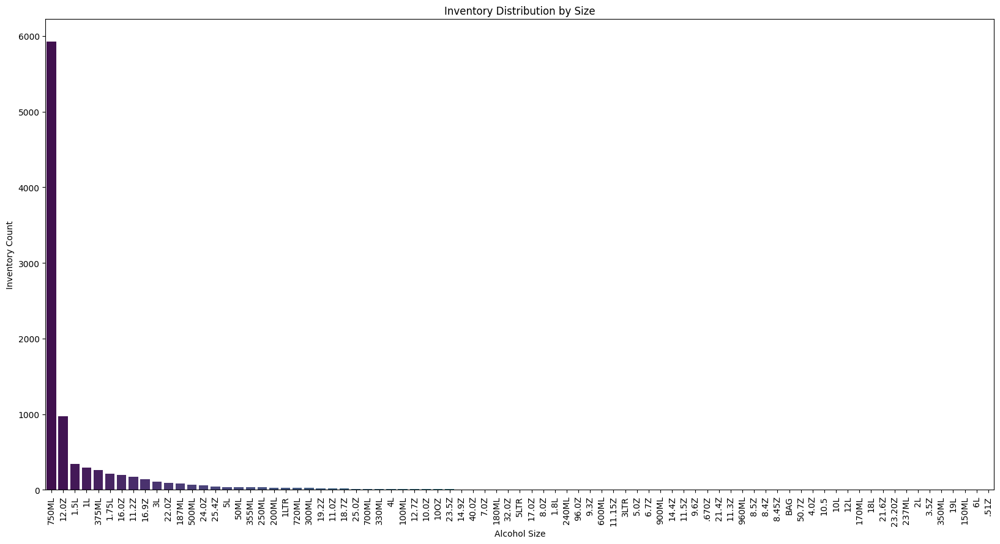

In [ ]:
# Insight-3: How does the inventory distribution vary across different sizes of alcohol products?

# This plot using Seaborn package

inventory_distribution = cleaned_df.groupby('Size')['Total Inventory'].count().reset_index()

plt.figure(figsize=(20, 10))

sns.barplot(data=inventory_distribution, x='Size', y='Total Inventory', palette='viridis', order=inventory_distribution.sort_values('Total Inventory', ascending=False)['Size'])
plt.title('Inventory Distribution by Size')
plt.xlabel('Alcohol Size')
plt.ylabel('Inventory Count')
plt.xticks(rotation=90)

plt.show()


In [ ]:
inventory_distribution.sort_values(by='Total Inventory', ascending=False)


,Size,Total Inventory
70,750ML,5925
15,12.0Z,972
2,1.5L,340
31,1L,298
52,375ML,262
...,...,...
50,350ML,1
30,19L,0
20,150ML,0
66,6L,0


In [ ]:
# Insight-4: Are there any correlations between the price and total inventory of alcohol products?

# This plot using Plotly package


fig = px.scatter(cleaned_df, x='Price', y='Total Inventory', title='<b>Are there any correlations between the price and total inventory of alcohol products?<br>(Correlation: Price vs Total Inventory)</b>',
                 labels={'Price': '<b>Price</b>', 'Total Inventory': '<b>Total Inventory</b>'},
                 color='Total Inventory')

fig.show()


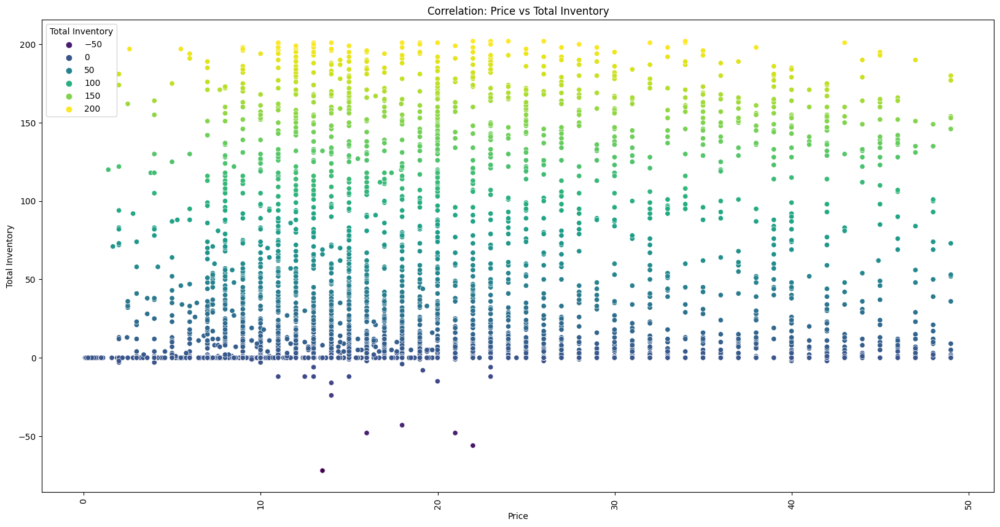

In [ ]:
# Insight-4: Are there any correlations between the price and total inventory of alcohol products?

# This plot using Seaborn package

plt.figure(figsize=(20, 10))

sns.scatterplot(data=cleaned_df, x='Price', y='Total Inventory', hue='Total Inventory', palette='viridis')
plt.title('Correlation: Price vs Total Inventory')
plt.xlabel('Price')
plt.ylabel('Total Inventory')
plt.xticks(rotation=90)

plt.show()

In [ ]:
# Insight-5: Which specific alcohol product has the highest price?

# This plot using Plotly package

highest_price_product = cleaned_df.loc[cleaned_df['Price'].idxmax()]
highest_price = highest_price_product['Price']
product_name = highest_price_product['Description']

highest_price_df = pd.DataFrame({'Description': [product_name], 'Price': [highest_price]})

colors = px.colors.qualitative.Plotly

fig = px.bar(highest_price_df, x='Description', y='Price', title='<b>Which specific alcohol product has the highest price?<br>(Alcohol Product with Highest Price)</b>',
             labels={'Description': '<b>Product</b>', 'Price': '<b>Price</b>'}, color='Description',
             color_discrete_sequence=colors)

fig.update_layout(xaxis_title='<b>Product</b>', yaxis_title='<b>Price</b>')

fig.show()


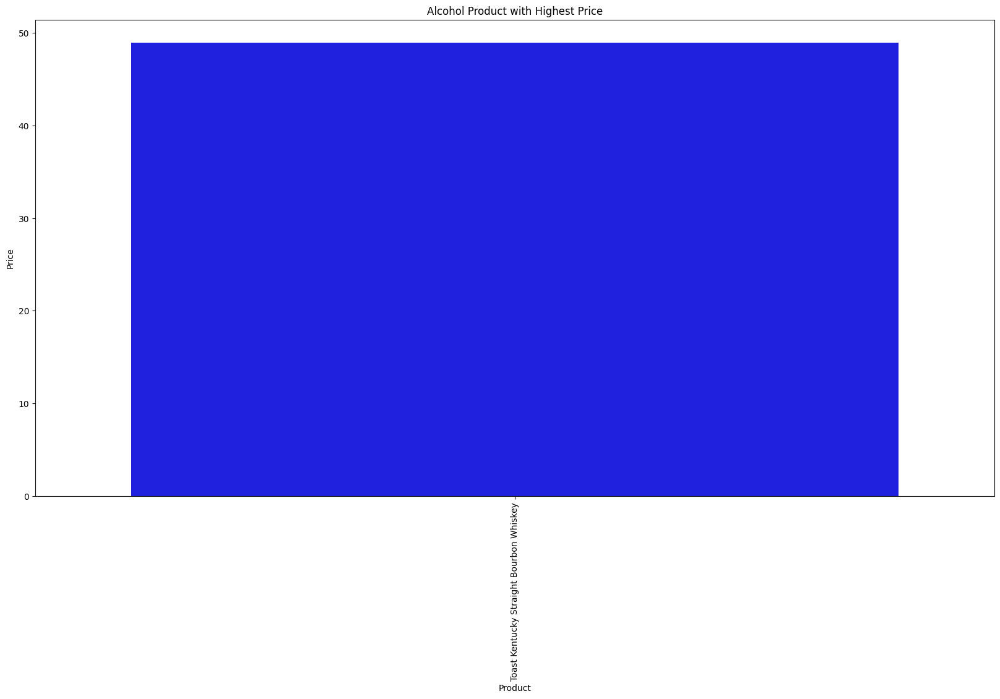

In [ ]:
# Insight-5: Which specific alcohol product has the highest price?

# This plot using Seaborn package

plt.figure(figsize=(20, 10))

highest_price_product = cleaned_df.loc[cleaned_df['Price'].idxmax()]
highest_price = highest_price_product['Price']
product_name = highest_price_product['Description']

sns.barplot(x=[product_name], y=[highest_price], color='blue')

plt.title('Alcohol Product with Highest Price')
plt.xlabel('Product')
plt.ylabel('Price')
plt.xticks(rotation=90)

plt.show()


In [ ]:
highest_price_product

Code                                                 15125
Category                                       BOURBON/RYE
Description        Toast Kentucky Straight Bourbon Whiskey
Size                                                 750ML
Total Inventory                                        180
Price                                                48.99
Name: 15, dtype: object

In [ ]:
# Insight-6: How does the average price differ between different sizes of alcohol products?

# This plot using Plotly package

average_price_by_size = cleaned_df.groupby('Size')['Price'].mean().sort_values(ascending=False).reset_index()

colors = px.colors.qualitative.Plotly

fig = px.bar(average_price_by_size, x='Size', y='Price', title='<b>How does the average price differ between different sizes of alcohol products?<br>(Average Price by Size)</b>',
             labels={'Size': '<b>Alcohol Size</b>', 'Price': '<b>Average Price</b>'}, color='Size',
             color_discrete_sequence=colors)

fig.update_layout(xaxis_title='<b>Size</b>', yaxis_title='<b>Average Price</b>')

fig.show()


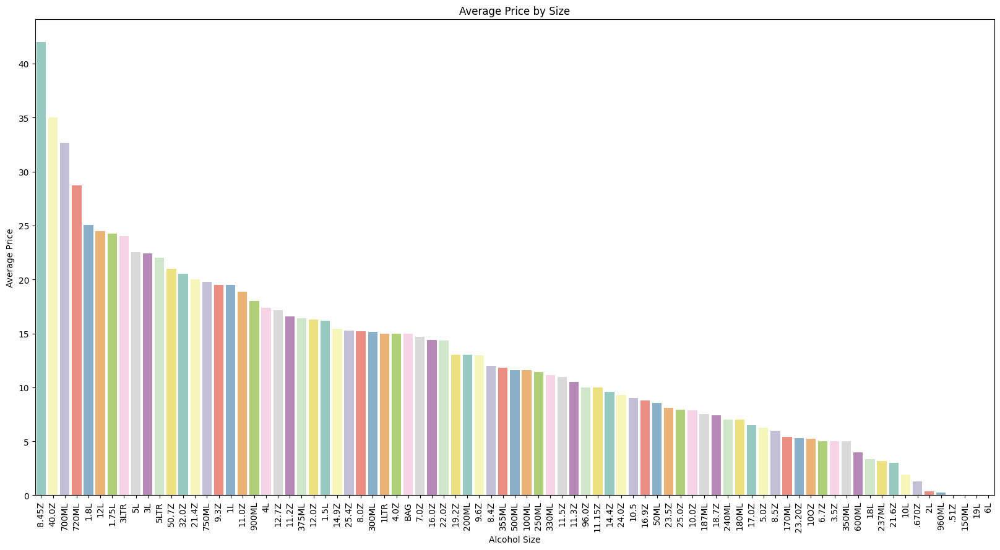

In [ ]:
# Insight-6: How does the average price differ between different sizes of alcohol products?

# This plot using Seborn package

average_price_by_size = cleaned_df.groupby('Size')['Price'].mean().sort_values(ascending=False).reset_index()

plt.figure(figsize=(20, 10))
sns.barplot(data=average_price_by_size, x='Size', y='Price', order=average_price_by_size['Size'], palette='Set3')

plt.title('Average Price by Size')
plt.xlabel('Alcohol Size')
plt.ylabel('Average Price')
plt.xticks(rotation=90)

plt.show()


In [ ]:
average_price_by_size.sort_values(by='Price', ascending=False)


,Size,Price
0,8.45Z,41.990000
1,40.0Z,34.990000
2,700ML,32.656667
3,720ML,28.693704
4,1.8L,25.070000
...,...,...
76,960ML,0.250000
77,.51Z,NaN
78,150ML,NaN
79,19L,NaN


In [ ]:
# Insight-7: Which category of alcohol has the highest average price?

# This plot using Plotly package


average_price_by_category = cleaned_df.groupby('Category')['Price'].mean().reset_index()

highest_average_price_category = average_price_by_category.loc[average_price_by_category['Price'].idxmax(), 'Category']

highest_average_price_category_df = average_price_by_category[average_price_by_category['Category'] == highest_average_price_category]

colors = px.colors.qualitative.Plotly

fig = px.bar(highest_average_price_category_df, x='Category', y='Price', title='<b>Which category of alcohol has the highest average price?<br>(Category with Highest Average Price)</b>',
             labels={'Category': '<b>Alcohol Category</b>', 'Price': '<b>Average Price</b>'}, color='Category',
             color_discrete_sequence=colors)

fig.update_layout(xaxis_title='<b>Category</b>', yaxis_title='<b>Average Price</b>')

fig.show()


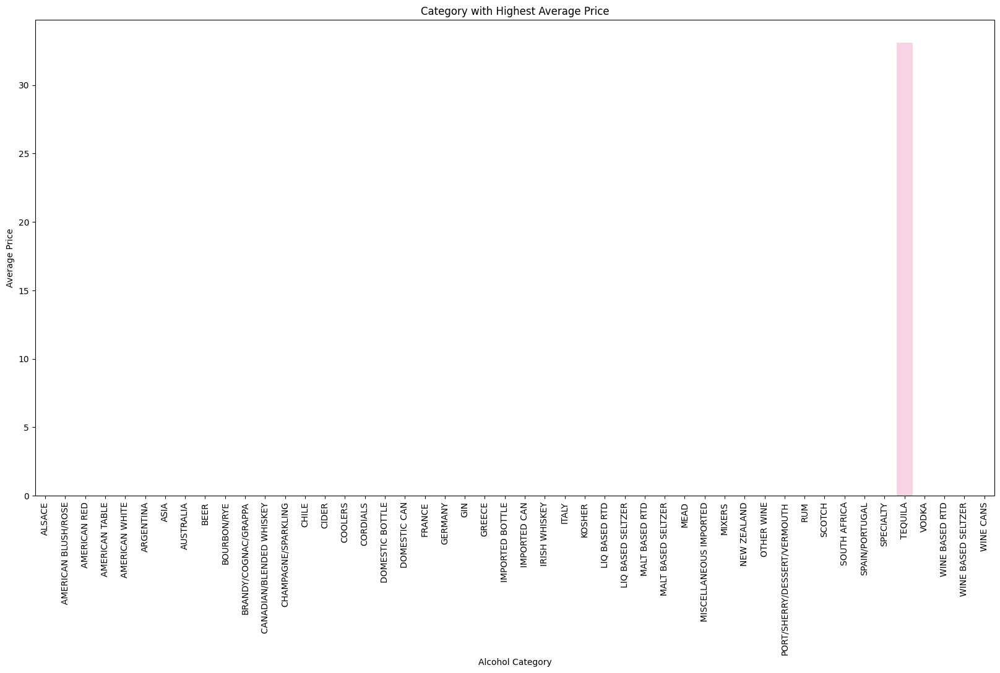

In [ ]:
# Insight-7: Which category of alcohol has the highest average price?

# This plot using Seaborn package

average_price_by_category = cleaned_df.groupby('Category')['Price'].mean().reset_index()
highest_average_price_category = average_price_by_category.loc[average_price_by_category['Price'].idxmax(), 'Category']
highest_average_price_category_df = average_price_by_category[average_price_by_category['Category'] == highest_average_price_category]

plt.figure(figsize=(20, 10))

sns.barplot(data=highest_average_price_category_df, x='Category', y='Price', palette='Set3')

plt.title('Category with Highest Average Price')
plt.xlabel('Alcohol Category')
plt.ylabel('Average Price')
plt.xticks(rotation=90)

plt.show()


In [ ]:
highest_average_price_category_df

,Category,Price
43,TEQUILA,33.102667


In [ ]:
# Insight-8: Which category of alcohol has the highest demand based on the total inventory and price?

# This plot using Plotly package

cleaned_df['Demand'] = cleaned_df['Total Inventory'] * cleaned_df['Price']

highest_demand_category = cleaned_df.groupby('Category')['Demand'].sum().idxmax()

highest_demand_category_df = cleaned_df[cleaned_df['Category'] == highest_demand_category]

fig = px.scatter(highest_demand_category_df, x='Total Inventory', y='Price', title='<b>Which category of alcohol has the highest demand based on the total inventory and price?<br>(Category with Highest Demand)</b>',
                 labels={'Total Inventory': '<b>Total Inventory</b>', 'Price': '<b>Price</b>'},
                  color='Category')

fig.update_layout(xaxis_title='<b>Total Inventory</b>', yaxis_title='<b>Price</b>')

fig.show()


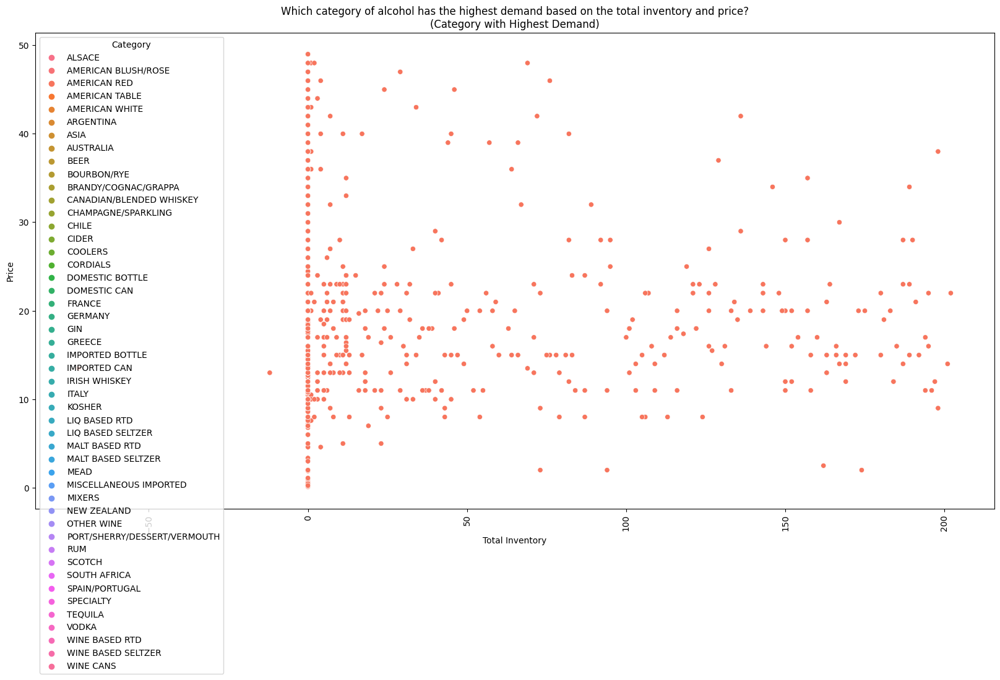

In [ ]:
# Insight-8: Which category of alcohol has the highest demand based on the total inventory and price?

# This plot using Seaborn package

cleaned_df['Demand'] = cleaned_df['Total Inventory'] * cleaned_df['Price']

highest_demand_category = cleaned_df.groupby('Category')['Demand'].sum().idxmax()

highest_demand_category_df = cleaned_df[cleaned_df['Category'] == highest_demand_category]

plt.figure(figsize=(20, 10))

sns.scatterplot(data=highest_demand_category_df, x='Total Inventory', y='Price', hue='Category')
plt.title('Which category of alcohol has the highest demand based on the total inventory and price?\n(Category with Highest Demand)')
plt.xlabel('Total Inventory')
plt.ylabel('Price')
plt.xticks(rotation=90)

plt.show()


In [ ]:
highest_demand_category

'AMERICAN RED'

In [ ]:
# Insight-9: How does the price and inventory vary for different descriptions within each category?

# This plot using Plotly package

category_description_stats = cleaned_df.groupby(['Category', 'Description']).agg({'Price': 'mean', 'Total Inventory': 'sum'}).reset_index()

colors = px.colors.qualitative.Plotly

fig = px.scatter(category_description_stats, x='Price', y='Total Inventory', color='Category', hover_data=['Description'],
                 title='<b>How does the price and inventory vary for different descriptions within each category?<br>(Price and Inventory Variation by Description)</b>', labels={'Price': '<b>Average Price</b>', 'Total Inventory': '<b>Total Inventory</b>'},
                 color_discrete_sequence=colors)

fig.update_layout(xaxis_title='<b>Average Price</b>', yaxis_title='<b>Total Inventory</b>')

fig.show()


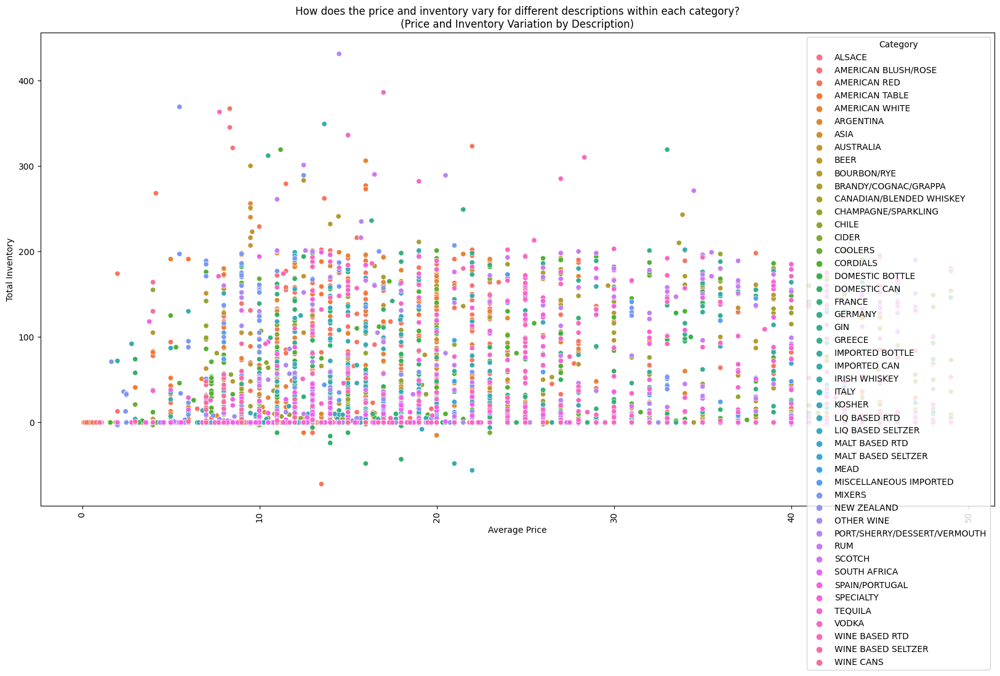

In [51]:
# Insight-9: How does the price and inventory vary for different descriptions within each category?

# This plot using Seaborn package

category_description_stats = cleaned_df.groupby(['Category', 'Description']).agg({'Price': 'mean', 'Total Inventory': 'sum'}).reset_index()

plt.figure(figsize=(20, 10))

sns.scatterplot(data=category_description_stats, x='Price', y='Total Inventory', hue='Category')
plt.title('How does the price and inventory vary for different descriptions within each category?\n(Price and Inventory Variation by Description)')
plt.xlabel('Average Price')
plt.ylabel('Total Inventory')
plt.xticks(rotation=90)

plt.show()

